In [14]:
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [15]:
seed = random.randint(1,10000)
print(f'random seed {seed}')
random.seed(seed)
torch.manual_seed(seed)
torch.use_deterministic_algorithms(True)

random seed 1369


# Setting helper variables

In [16]:
rootdir = '/kaggle/input/celeba-dataset/img_align_celeba' # root directory of the data

workers = 2             # number of worker for dataset

batch_size = 128        # size of batch for training

img_size = 64           # size of input images

nc = 3                  # number of color channel in images

nz = 100                # lenght of latent vector

ngf = 64                # Size of feature maps in generator

ndf = 64                # Size of feature maps in discriminator

n_epochs = 20           # number of epochs

lr = 0.0002             # learning rate

beta1 = 0.5             # beta1 hyperparameter for Adam optimizers



# Loading Dataset

In [17]:
dataset = dset.ImageFolder(root= rootdir, transform= transforms.Compose([
                          transforms.Resize(img_size),
                          transforms.CenterCrop(img_size),
                          transforms.ToTensor(),
                          transforms.Normalize((0.5,0.5,0.5), (0.5,0.5,0.5))]))

dataloader = torch.utils.data.DataLoader(dataset, batch_size= batch_size, shuffle= True, num_workers= workers)

if torch.cuda.is_available():
    device = 'cuda'
else:
  device = 'cpu'

print(device)

cuda


## Visualising Data

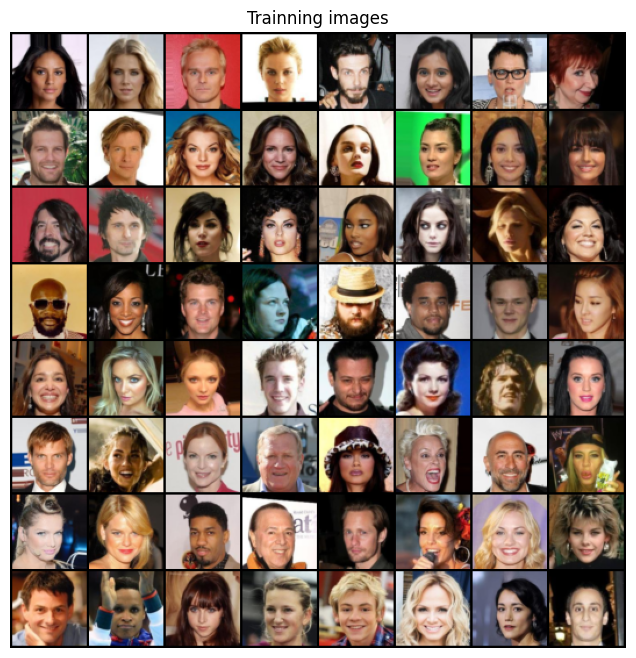

In [18]:
batch =next(iter(dataloader))
plt.figure(figsize= (8,8))
plt.axis('off')
plt.title('Trainning images')
plt.imshow(np.transpose(vutils.make_grid(batch[0].to(device)[:64], padding= 2, normalize= True).cpu(), (1,2,0)))
plt.show()

# Initializing Networks Weights


In [19]:
def weigths_initializer(w) -> None:
    classname = w.__init__.__name__
    
    if classname.find('Conv') != -1:
        nn.init.normal(w.wheight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal(w.wheight.data, 1.0, 0.02)
        nn.init.constant(w.bias.data, 0)

# Building the Generator

In [20]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz,ngf*8,4,1,0, bias= False),
            nn.BatchNorm2d(ngf*8),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(ngf*8, ngf*4,4,2,1, bias= False),
            nn.BatchNorm2d(ngf*4),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(ngf*4, ngf*2,4,2,1, bias= False),
            nn.BatchNorm2d(ngf*2),
            nn.ReLU(True),
            
            
            nn.ConvTranspose2d(ngf*2, ngf, 4,2,1, bias= False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(ngf, nc, 4,2,1, bias= False),
            nn.Tanh()
        )
        
    def forward(self, input):
        return self.main(input)

In [21]:
Gnet = Generator().to(device)
Gnet.apply(weigths_initializer)

print(Gnet)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


# Bulding the Discriminator

In [22]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.main = nn.Sequential(
            nn.Conv2d(nc,ndf, 4,2,1, bias= False),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(ndf,ndf * 2,4,2,1, bias= False),
            nn.BatchNorm2d(ndf*2),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(ndf * 2,ndf * 4,4,2,1, bias= False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(ndf * 4,ndf * 8,4,2,1, bias= False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(ndf * 8,1,4,1,0, bias= False),
            nn.Sigmoid()
        )
        
    def forward(self,input):
        return self.main(input)

In [23]:
Dnet = Discriminator().to(device)
Dnet.apply(weigths_initializer)

print(Dnet)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


# Defining Loss and Optimizers

In [24]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz,1,1, device=device)

real_label = 1
fake_label = 0

d_optimizer = optim.Adam(Dnet.parameters(), lr=lr, betas= (beta1, 0.999))
g_optimizer = optim.Adam(Gnet.parameters(), lr=lr, betas= (beta1, 0.999))

# Training

In [25]:
img_list = []
G_losses = []
D_losses = []
iters = 0

for epoch in range(n_epochs):
    for i, data in enumerate(dataloader,0):
        # Update D network
        Dnet.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,),real_label, dtype=torch.float, device=device)
        output = Dnet(real_cpu).view(-1)
        d_err_real = criterion(output, label)
        d_err_real.backward()
        D_x = output.mean().item()
        
        # Train with all-fake batch
        noise = torch.randn(b_size, nz, 1,1, device=device)
        fake = Gnet(noise)
        label.fill_(fake_label)
        output = Dnet(fake.detach()).view(-1)
        d_err_fake = criterion(output, label)
        d_err_fake.backward()
        D_G_z1 = output.mean().item()
        d_err = d_err_real + d_err_fake
        d_optimizer.step()
        
        #Update G network
        Gnet.zero_grad()
        label.fill_(real_label)
        output = Dnet(fake).view(-1)
        g_err = criterion(output, label)
        g_err.backward()
        D_G_z2 = output.mean().item()
        g_optimizer.step()
        
        # Output training stats
        if i % 50 == 0:
            print(f'Epoch: [{epoch}|{n_epochs}] D_Loss: {d_err.item()} G_Loss: {g_err.item()} D(x): {D_x}  D(G(z)): {D_G_z1/D_G_z2}')
            
        G_losses.append(g_err.item())
        D_losses.append(d_err.item())
        
        if (iters % 500 == 1) or (epoch == n_epochs-1) and (i == len(dataloader)-1):
            with torch.no_grad():
                fake = Gnet(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
                            
        iters +=1
            
        

        

Epoch: [0|20] D_Loss: 1.3049249649047852 G_Loss: 3.20682430267334 D(x): 0.5654938220977783  D(G(z)): 11.768569816722264
Epoch: [0|20] D_Loss: 0.3102552890777588 G_Loss: 13.694780349731445 D(x): 0.8187200427055359  D(G(z)): 1.1837761516894967
Epoch: [0|20] D_Loss: 0.38176456093788147 G_Loss: 8.544053077697754 D(x): 0.9859391450881958  D(G(z)): 1093.3674247363606
Epoch: [0|20] D_Loss: 1.4660309553146362 G_Loss: 2.401578903198242 D(x): 0.33148741722106934  D(G(z)): 0.3169620295151865
Epoch: [0|20] D_Loss: 0.652764081954956 G_Loss: 2.8756227493286133 D(x): 0.798090934753418  D(G(z)): 4.446514897664398
Epoch: [0|20] D_Loss: 0.5406757593154907 G_Loss: 2.8691110610961914 D(x): 0.6852766275405884  D(G(z)): 1.2477766239014885
Epoch: [0|20] D_Loss: 2.2869935035705566 G_Loss: 2.61196231842041 D(x): 0.18847164511680603  D(G(z)): 0.06867412079672634
Epoch: [0|20] D_Loss: 0.5552417039871216 G_Loss: 3.1584982872009277 D(x): 0.789027750492096  D(G(z)): 4.479711107406967
Epoch: [0|20] D_Loss: 1.7527511

# Result

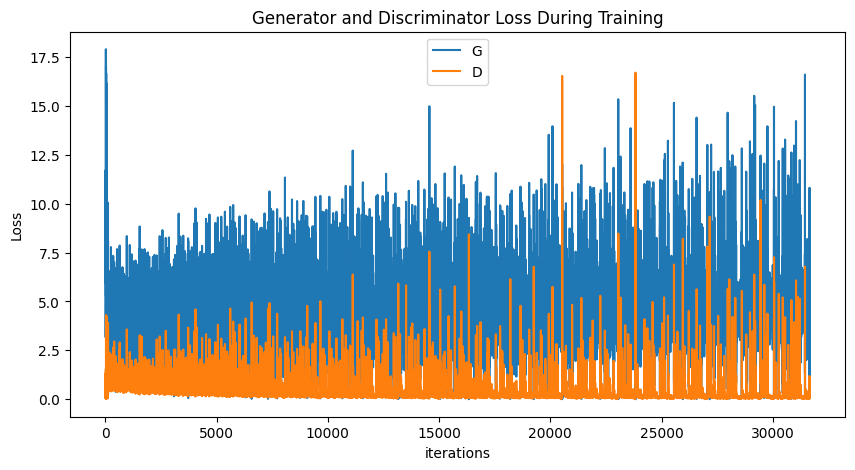

In [26]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

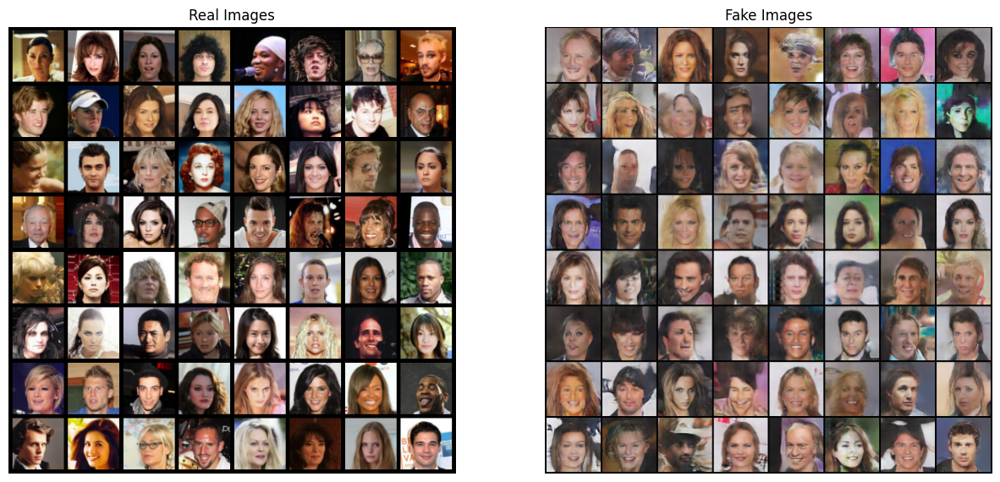

In [35]:
# Grab a batch of real images 
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

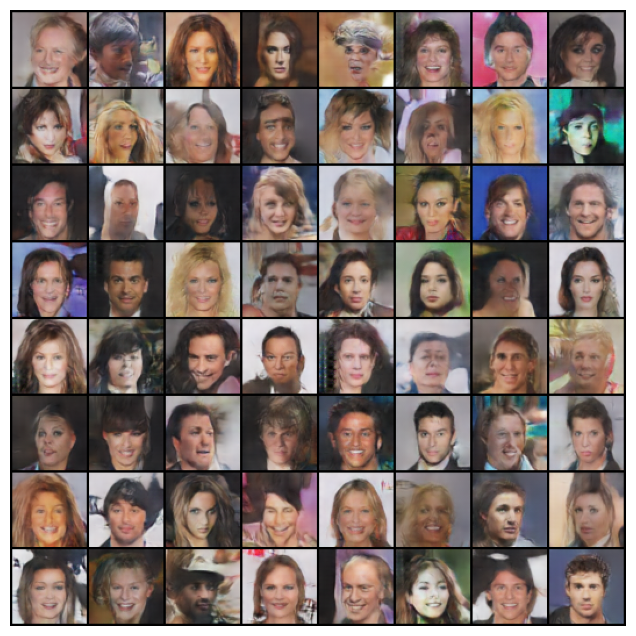

In [32]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
ani.save(filename= '/kaggle/working/evo.gif', writer= 'pillow' )

HTML(ani.to_jshtml())